In [21]:
import sys
# sys.path.append('src')
import os
import numpy as np
import pandas as pd
import torch
import matplotlib
import matplotlib.pyplot as plt

import seaborn as sns
import sklearn
import phate
import hdbscan
import scprep

import sys
import rootutils
project_root = rootutils.setup_root(os.getcwd(), indicator=".project-root", pythonpath=True)
sys.path.append(os.path.join(project_root, 'src'))

import src.data_loader as dataloader
from src.data_loader import load_data_1000G, load_data_HGDP
import src.mappings as mappings
from src.train_AE import DenoisingAutoencoder
from src.preprocess import maf_scale
from src.mappings import make_palette_label_order_HGDP

from dotenv import load_dotenv
dotenv_path = os.path.join(project_root, '.env')


In [22]:
# Load environment variables
path = load_dotenv(dotenv_path)
PROJECT_PATH = os.getenv('PROJECT_PATH')
SCRATCH_PATH = os.getenv('SCRATCH_PATH')
SAVE_PATH = os.getenv('SAVE_PATH')
Figure_PATH = os.getenv('Figure_PATH')

In [23]:
DATA_PATH = SCRATCH_PATH + 'data/HGDP+1KGP/V4/'
merged_metadata, relatedness, data, mapping_info= load_data_HGDP(DATA_PATH)
samples = merged_metadata.index
label_pop = merged_metadata['Population']  
label_genetic_region = merged_metadata['Genetic_region']
cmap_genetic_region, cmap_pop, order_genetic_region, order_pop = mapping_info

In [24]:
# normalize data
maf_scaled_data = maf_scale(data)
data_tensor = torch.from_numpy(maf_scaled_data).float()
input_dim = data.shape[1]

# 100D AE + PHATE

In [31]:
# trained model path
model_save_path = SAVE_PATH + 'HGDP/AE/ae_trained_model_HGDP.pth'

In [32]:
# Initialize the model
latent_dim = 100  # Latent space dimension
model = DenoisingAutoencoder(input_dim=input_dim, latent_dim=latent_dim)

# Load the trained model's weights
model.load_state_dict(torch.load(model_save_path))
model.eval()  # Set the model to evaluation mode

# Assuming `data` is your input tensor, move it to the correct device if necessary
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)
data = data_tensor.to(device)  # Move data to device

# Use the encoder for inference (dimensionality reduction)
with torch.no_grad():  # Disable gradient computation for inference
    reduced_data = model.encoder(data)

In [33]:
reduced_data_np = reduced_data.cpu().numpy()

In [34]:
# initial phate embedding
phate_operator_2d = phate.PHATE(random_state=42, 
                                n_components=2, 
                                knn=10, 
                                t=6, 
                                decay=60,
                                n_pca=None)
phate_operator_2d.fit(reduced_data_np)
phate_emb_2d = phate_operator_2d.transform()

Running PHATE on 4150 observations and 100 variables.
Calculating graph and diffusion operator...
  Calculating KNN search...
  Calculated KNN search in 2.38 seconds.
  Calculating affinities...
  Calculated affinities in 0.04 seconds.
Calculated graph and diffusion operator in 2.42 seconds.
Calculating landmark operator...
  Calculating SVD...
  Calculated SVD in 0.39 seconds.
  Calculating KMeans...
  Calculated KMeans in 2.94 seconds.
Calculated landmark operator in 4.66 seconds.
Calculating diffusion potential...
Calculated diffusion potential in 0.42 seconds.
Calculating metric MDS...
Calculated metric MDS in 5.42 seconds.


<Axes: title={'center': 'HGDP superpopulation'}, xlabel='PHATE 1', ylabel='PHATE 2'>

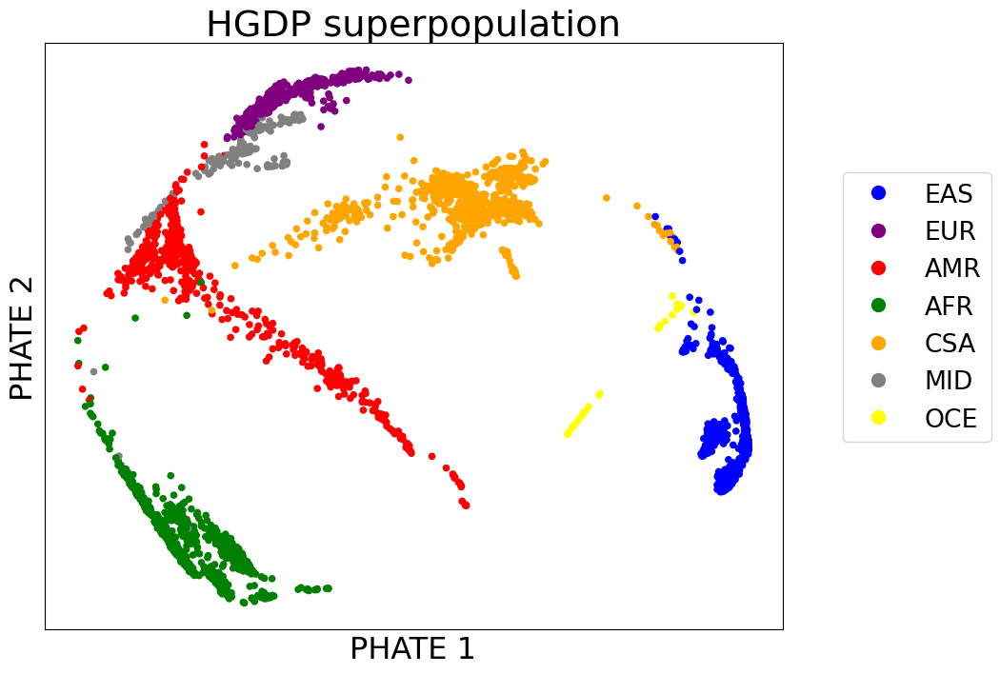

In [35]:
fig, axes = plt.subplots(1,1, figsize=(10, 8))

scprep.plot.scatter2d(phate_emb_2d, s=20, ax=axes,
                      cmap=cmap_genetic_region, c=label_genetic_region,
                      xticks=False, yticks=False, legend=True,
                      legend_loc='right', legend_anchor=(1.3, 0.55), legend_ncol=1,
                      label_prefix="PHATE ",title='HGDP superpopulation', fontsize=16)
# scprep.plot.scatter2d(phate_emb_2d[~mask_cluster], s=20, ax=axes,
#                       c='black', 
#                       xticks=False, yticks=False, legend=False,
#                     #   legend_loc='right', legend_anchor=(1.3, 0.55), legend_ncol=1,
#                       label_prefix="PHATE ",title='HGDP superpopulation', fontsize=16)

<Axes: title={'center': 'HGDP superpopulation'}, xlabel='PHATE 1', ylabel='PHATE 2'>

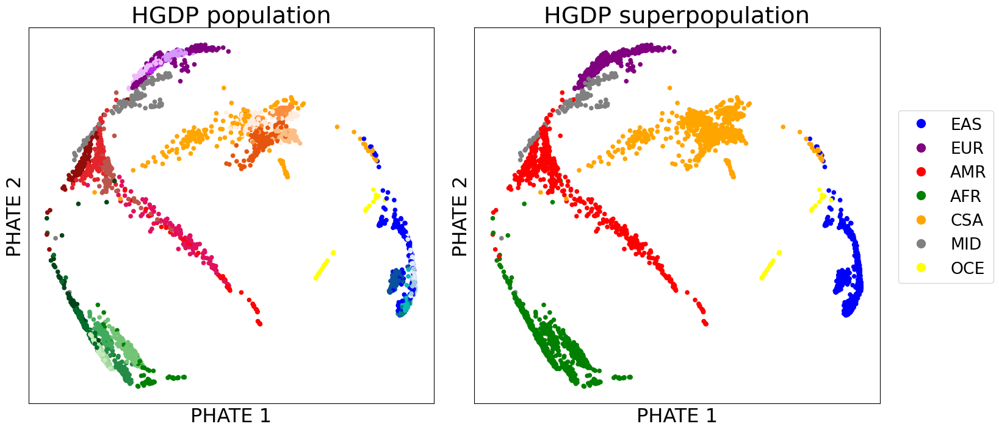

In [36]:
fig, axes = plt.subplots(1,2, figsize=(18, 8), gridspec_kw={'width_ratios': [1, 1], 'wspace': 0.1})

scprep.plot.scatter2d(phate_emb_2d, s=20, ax=axes[0],
                      cmap=cmap_pop, c=label_pop,
                      xticks=False, yticks=False, legend=False,
                      label_prefix="PHATE ",title='HGDP population', fontsize=16)
scprep.plot.scatter2d(phate_emb_2d, s=20, ax=axes[1],
                      cmap=cmap_genetic_region, c=label_genetic_region,
                      xticks=False, yticks=False, legend=True,
                      legend_loc='right', legend_anchor=(1.3, 0.55), legend_ncol=1,
                      label_prefix="PHATE ",title='HGDP superpopulation', fontsize=16)

In [58]:
# initial phate embedding
phate_operator_3d = phate.PHATE(random_state=42, 
                                n_components=3, 
                                knn=10, 
                                t=6, 
                                decay=60,
                                n_pca=None)
phate_operator_3d.fit(reduced_data_np)
phate_emb_3d = phate_operator_3d.transform()

Running PHATE on 3449 observations and 100 variables.
Calculating graph and diffusion operator...
  Calculating KNN search...
  Calculated KNN search in 1.36 seconds.
  Calculating affinities...
  Calculated affinities in 0.03 seconds.
Calculated graph and diffusion operator in 1.40 seconds.
Calculating landmark operator...
  Calculating SVD...
  Calculated SVD in 0.27 seconds.
  Calculating KMeans...
  Calculated KMeans in 2.68 seconds.
Calculated landmark operator in 4.15 seconds.
Calculating diffusion potential...
Calculated diffusion potential in 0.37 seconds.
Calculating metric MDS...


/home/mila/s/shuang.ni/.conda/envs/genetics/lib/python3.10/site-packages/sklearn/manifold/_mds.py:299: FutureWarning: The default value of `normalized_stress` will change to `'auto'` in version 1.4. To suppress this warning, manually set the value of `normalized_stress`.
  warnings.warn(


Calculated metric MDS in 16.67 seconds.


In [59]:
scprep.plot.rotate_scatter3d(phate_emb_3d, 
                              c=label_genetic_region, 
                              figsize=(8,6),
                              cmap=cmap_genetic_region,
                              ticks=False, label_prefix="PHATE",
                              filename=Figure_PATH + '1000G+HGDP_PHATE_3D.mp4')

## remove AMR

In [12]:
mask = np.isin(label_genetic_region, ['AMR'])
data_noAMR = data[~mask]

In [13]:
# normalize data
maf_scaled_data = maf_scale(data_noAMR)
data_tensor = torch.from_numpy(maf_scaled_data).float()
input_dim = data_noAMR.shape[1]

In [14]:
data = data_tensor.to(device)  # Move data to device

# Use the encoder for inference (dimensionality reduction)
with torch.no_grad():  # Disable gradient computation for inference
    reduced_data = model.encoder(data)

In [15]:
reduced_data_np = reduced_data.cpu().numpy()

In [16]:
# initial phate embedding
phate_operator_2d = phate.PHATE(random_state=42, 
                                n_components=2, 
                                knn=25, 
                                t=5, 
                                decay=60,
                                n_pca=None)
phate_operator_2d.fit(reduced_data_np)
phate_emb_2d = phate_operator_2d.transform()

Running PHATE on 3040 observations and 100 variables.
Calculating graph and diffusion operator...
  Calculating KNN search...
  Calculated KNN search in 1.14 seconds.
  Calculating affinities...
  Calculated affinities in 0.04 seconds.
Calculated graph and diffusion operator in 1.19 seconds.
Calculating landmark operator...
  Calculating SVD...
  Calculated SVD in 0.30 seconds.
  Calculating KMeans...
  Calculated KMeans in 2.05 seconds.
Calculated landmark operator in 3.51 seconds.
Calculating diffusion potential...
Calculated diffusion potential in 0.31 seconds.
Calculating metric MDS...
Calculated metric MDS in 3.90 seconds.


<Axes: title={'center': 'HGDP superpopulation'}, xlabel='PHATE 1', ylabel='PHATE 2'>

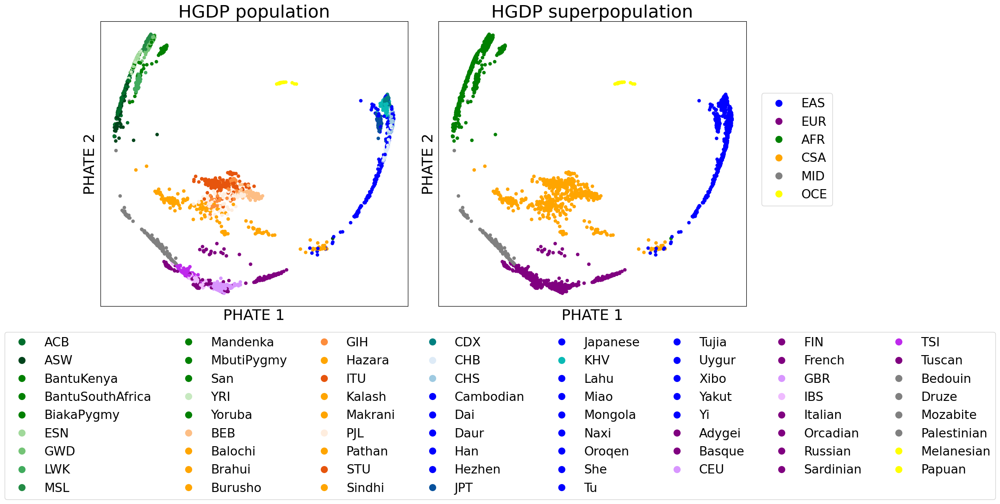

In [17]:
fig, axes = plt.subplots(1,2, figsize=(18, 8), gridspec_kw={'width_ratios': [1, 1], 'wspace': 0.1})

scprep.plot.scatter2d(phate_emb_2d, s=20, ax=axes[0],
                      cmap=cmap_pop, c=label_pop[~mask],
                      xticks=False, yticks=False, legend=True,
                      legend_loc='lower center', legend_anchor=(1.3, -0.7), legend_ncol=8,
                      label_prefix="PHATE ",title='HGDP population', fontsize=16)
scprep.plot.scatter2d(phate_emb_2d, s=20, ax=axes[1],
                      cmap=cmap_genetic_region, c=label_genetic_region[~mask],
                      xticks=False, yticks=False, legend=True,
                      legend_loc='right', legend_anchor=(1.3, 0.55), legend_ncol=1,
                      label_prefix="PHATE ",title='HGDP superpopulation', fontsize=16)

In [19]:
phate_clusters = phate.cluster.kmeans(phate_operator_2d, n_clusters=20)

/home/mila/s/shuang.ni/.conda/envs/genetics/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


/home/mila/s/shuang.ni/.conda/envs/genetics/lib/python3.10/site-packages/scprep/plot/utils.py:99: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  fig.tight_layout()


<Axes: title={'center': 'HGDP population'}, xlabel='PHATE 1', ylabel='PHATE 2'>

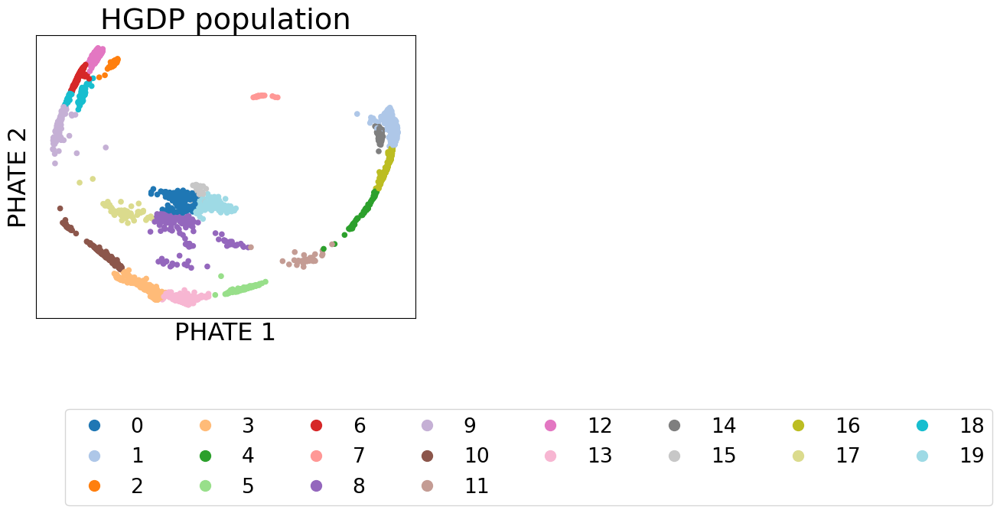

In [21]:
scprep.plot.scatter2d(phate_emb_2d, s=20,
                      cmap='tab20', c=phate_clusters,
                      xticks=False, yticks=False, legend=True,
                      legend_loc='lower center', legend_anchor=(1.3, -0.7), legend_ncol=8,
                      label_prefix="PHATE ",title='HGDP population', fontsize=16)

In [22]:
CSA_EAS_mix = (phate_clusters == 11)

In [27]:
original_pop = label_pop[~mask]
CSA_EAS_mix_pop = original_pop[CSA_EAS_mix]
CSA_EAS_mix_pop

array(['Hazara', 'Hazara', 'Hazara', 'Hazara', 'Hazara', 'Hazara',
       'Hazara', 'Hazara', 'Hazara', 'Hazara', 'Hazara', 'Hazara',
       'Hazara', 'Hazara', 'Hazara', 'Hazara', 'Hazara', 'Hazara',
       'Burusho', 'Uygur', 'Uygur', 'Uygur', 'Uygur', 'Uygur', 'Uygur',
       'Uygur', 'Uygur', 'Hazara', 'Hazara', 'Uygur', 'Uygur', 'ASW'],
      dtype=object)

In [26]:
original_superpop = label_genetic_region[~mask]
CSA_EAS_mix_superpop = original_superpop[CSA_EAS_mix]
CSA_EAS_mix_superpop

array(['CSA', 'CSA', 'CSA', 'CSA', 'CSA', 'CSA', 'CSA', 'CSA', 'CSA',
       'CSA', 'CSA', 'CSA', 'CSA', 'CSA', 'CSA', 'CSA', 'CSA', 'CSA',
       'CSA', 'EAS', 'EAS', 'EAS', 'EAS', 'EAS', 'EAS', 'EAS', 'EAS',
       'CSA', 'CSA', 'EAS', 'EAS', 'AFR'], dtype=object)

In [28]:
dict(zip(*np.unique(CSA_EAS_mix_pop, return_counts=True)))

{'ASW': 1, 'Burusho': 1, 'Hazara': 20, 'Uygur': 10}

In [29]:
dict(zip(*np.unique(CSA_EAS_mix_superpop, return_counts=True)))

{'AFR': 1, 'CSA': 21, 'EAS': 10}

<Axes: title={'center': 'HGDP superpopulation'}, xlabel='PHATE 1', ylabel='PHATE 2'>

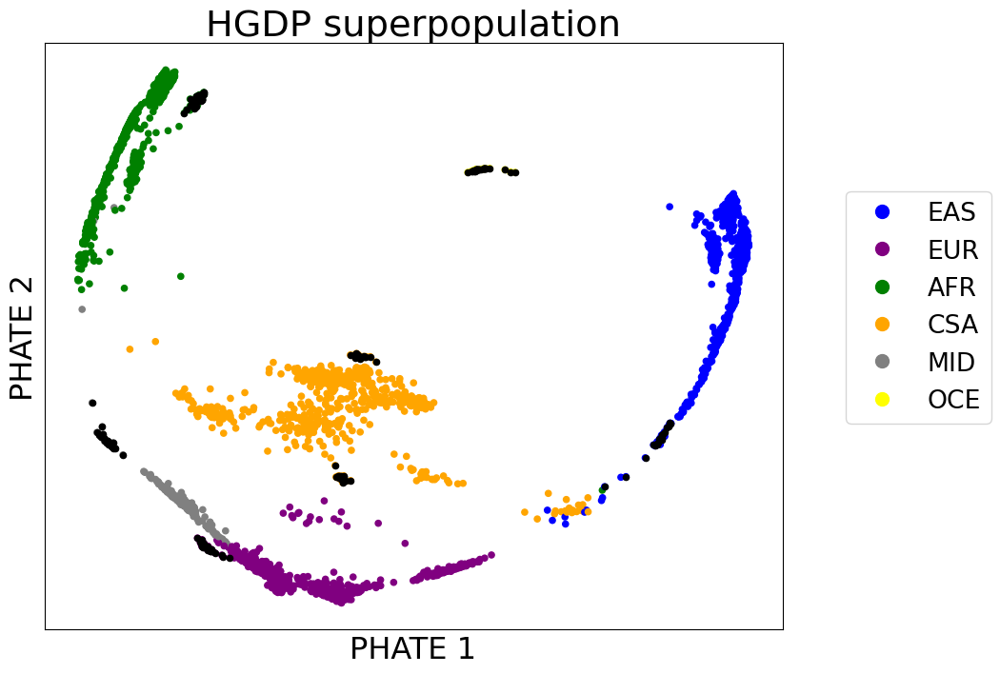

In [50]:
new_mask = mask_cluster[~mask]
fig, axes = plt.subplots(1,1, figsize=(10, 8))

scprep.plot.scatter2d(phate_emb_2d, s=20, ax=axes,
                      cmap=cmap_genetic_region, c=label_genetic_region[~mask],
                      xticks=False, yticks=False, legend=True,
                      legend_loc='right', legend_anchor=(1.3, 0.55), legend_ncol=1,
                      label_prefix="PHATE ",title='HGDP superpopulation', fontsize=16)
scprep.plot.scatter2d(phate_emb_2d[~new_mask], s=20, ax=axes,
                      c='black', 
                      xticks=False, yticks=False, legend=False,
                    #   legend_loc='right', legend_anchor=(1.3, 0.55), legend_ncol=1,
                      label_prefix="PHATE ",title='HGDP superpopulation', fontsize=16)

In [87]:
# initial phate embedding
phate_operator_3d = phate.PHATE(random_state=42, 
                                n_components=3, 
                                knn=15, 
                                t=6, 
                                decay=40,
                                n_pca=None)
phate_operator_3d.fit(reduced_data_np)
phate_emb_3d = phate_operator_3d.transform()

Running PHATE on 3040 observations and 100 variables.
Calculating graph and diffusion operator...
  Calculating KNN search...
  Calculated KNN search in 1.06 seconds.
  Calculating affinities...
  Calculated affinities in 0.03 seconds.
Calculated graph and diffusion operator in 1.09 seconds.
Calculating landmark operator...
  Calculating SVD...
  Calculated SVD in 0.28 seconds.
  Calculating KMeans...
  Calculated KMeans in 3.18 seconds.
Calculated landmark operator in 4.58 seconds.
Calculating diffusion potential...
Calculated diffusion potential in 0.32 seconds.
Calculating metric MDS...


/home/mila/s/shuang.ni/.conda/envs/genetics/lib/python3.10/site-packages/sklearn/manifold/_mds.py:299: FutureWarning: The default value of `normalized_stress` will change to `'auto'` in version 1.4. To suppress this warning, manually set the value of `normalized_stress`.
  warnings.warn(


Calculated metric MDS in 33.80 seconds.


In [88]:
scprep.plot.rotate_scatter3d(phate_emb_3d, 
                              c=label_genetic_region[~mask], 
                              figsize=(8,6),
                              cmap=cmap_genetic_region,
                              ticks=False, label_prefix="PHATE",
                              filename=Figure_PATH + '1000G+HGDP_PHATE_3D_noAMR_2.mp4')

# PCA + PHATE

In [5]:
# normalize data
maf_scaled_data = maf_scale(data)
pca_obj = sklearn.decomposition.PCA(n_components=100, random_state=2)
pca_input = pca_obj.fit_transform(maf_scaled_data)

In [6]:
# initial phate embedding
phate_operator_2d_pca = phate.PHATE(random_state=42, 
                                n_components=2, 
                                knn=6, 
                                t=6, 
                                decay=60,
                                n_pca=None)
phate_operator_2d_pca.fit(pca_input)
phate_emb_2d_pca = phate_operator_2d_pca.transform()

Running PHATE on 3449 observations and 100 variables.
Calculating graph and diffusion operator...
  Calculating KNN search...
  Calculated KNN search in 1.41 seconds.
  Calculating affinities...
  Calculated affinities in 0.04 seconds.
Calculated graph and diffusion operator in 1.46 seconds.
Calculating landmark operator...
  Calculating SVD...
  Calculated SVD in 0.38 seconds.
  Calculating KMeans...
  Calculated KMeans in 2.66 seconds.
Calculated landmark operator in 4.21 seconds.
Calculating diffusion potential...
Calculated diffusion potential in 0.36 seconds.
Calculating metric MDS...
Calculated metric MDS in 4.53 seconds.


<Axes: title={'center': 'HGDP superpopulation'}, xlabel='PHATE 1', ylabel='PHATE 2'>

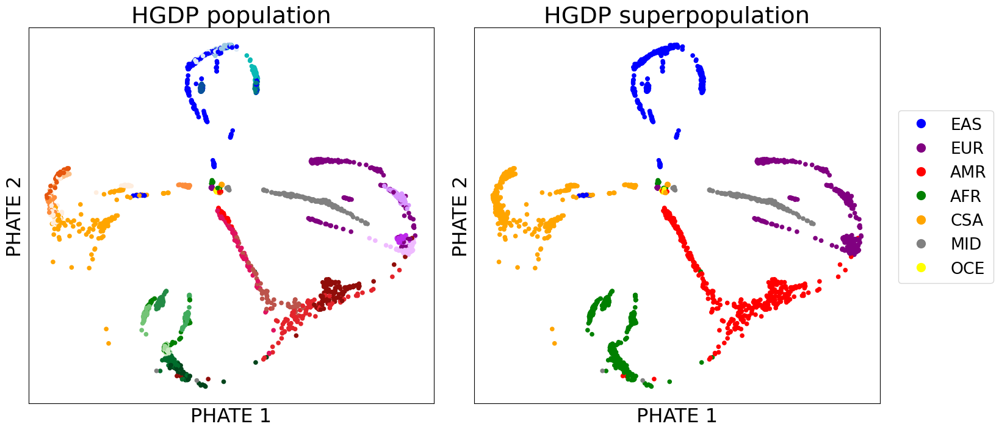

In [7]:
fig, axes = plt.subplots(1,2, figsize=(18, 8), gridspec_kw={'width_ratios': [1, 1], 'wspace': 0.1})

scprep.plot.scatter2d(phate_emb_2d_pca, s=20, ax=axes[0],
                      cmap=cmap_pop, c=label_pop,
                      xticks=False, yticks=False, legend=False,
                      label_prefix="PHATE ",title='HGDP population', fontsize=16)
scprep.plot.scatter2d(phate_emb_2d_pca, s=20, ax=axes[1],
                      cmap=cmap_genetic_region, c=label_genetic_region,
                      xticks=False, yticks=False, legend=True,
                      legend_loc='right', legend_anchor=(1.3, 0.55), legend_ncol=1,
                      label_prefix="PHATE ",title='HGDP superpopulation', fontsize=16)

In [8]:
phate_labels = phate.cluster.kmeans(phate_operator_2d_pca, n_clusters=24)

/home/mila/s/shuang.ni/.conda/envs/genetics/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [9]:
mask_cluster = (phate_labels != 12)
mask_cluster
# save mask_cluster
np.save(DATA_PATH + 'mask_cluster.npy', mask_cluster)

array([ True,  True,  True, ...,  True,  True,  True])

In [46]:
np.save(DATA_PATH + 'mask_cluster.npy', mask_cluster)

<Axes: title={'center': 'HGDP population'}, xlabel='PHATE 1', ylabel='PHATE 2'>

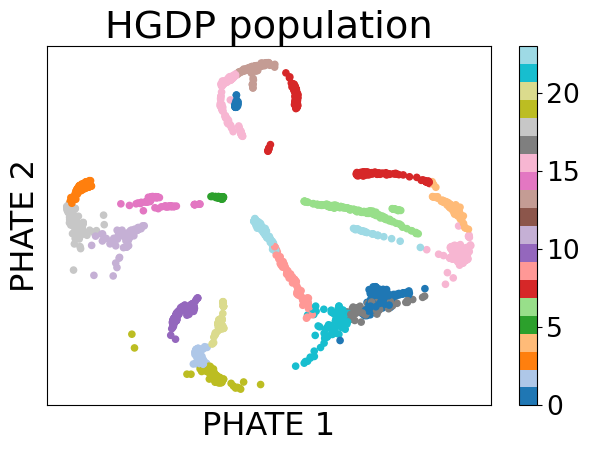

In [10]:
scprep.plot.scatter2d(phate_emb_2d_pca[mask_cluster], s=20,
                      cmap='tab20', c=phate_labels[mask_cluster],
                      xticks=False, yticks=False, legend=True,
                      label_prefix="PHATE ",title='HGDP population', fontsize=16)

# 2D AE embedding

In [6]:
# trained model path
model_save_path = SAVE_PATH + 'AE/ae_trained_model_2D_HGDP.pth'

In [7]:
# Initialize the model
latent_dim = 2  # Latent space dimension
model = DenoisingAutoencoder(input_dim=input_dim, latent_dim=latent_dim)

# Load the trained model's weights
model.load_state_dict(torch.load(model_save_path))
model.eval()  # Set the model to evaluation mode

# Assuming `data` is your input tensor, move it to the correct device if necessary
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)
data = data_tensor.to(device)  # Move data to device

# Use the encoder for inference (dimensionality reduction)
with torch.no_grad():  # Disable gradient computation for inference
    reduced_data = model.encoder(data)

In [8]:
reduced_data_np = reduced_data.cpu().numpy()

In [12]:
df = pd.DataFrame(reduced_data_np)
df.index = samples
df.to_csv('/home/mila/s/shuang.ni/phate_genetics/data/HGDP/HGDP_2D_AE_emb.csv')

<Axes: title={'center': 'HGDP superpopulation'}, xlabel='AE 1', ylabel='AE 2'>

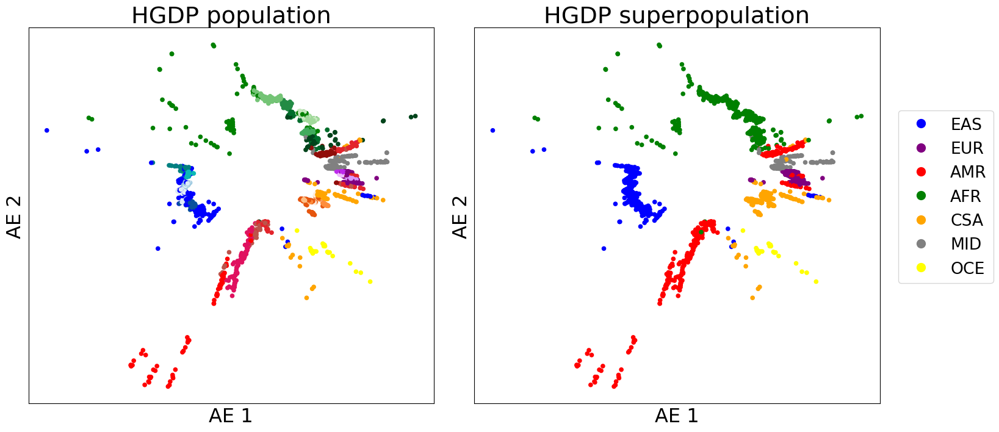

In [17]:
fig, axes = plt.subplots(1,2, figsize=(18, 8), gridspec_kw={'width_ratios': [1, 1], 'wspace': 0.1})

scprep.plot.scatter2d(reduced_data_np, s=20, ax=axes[0],
                      cmap=cmap_pop, c=label_pop,
                      xticks=False, yticks=False, legend=False,
                      # legend_loc='lower center', legend_anchor=(1.3, -0.7), legend_ncol=8,
                      label_prefix="AE ",title='HGDP population', fontsize=16)
scprep.plot.scatter2d(reduced_data_np, s=20, ax=axes[1],
                      cmap=cmap_genetic_region, c=label_genetic_region,
                      xticks=False, yticks=False, legend=True,
                      legend_loc='right', legend_anchor=(1.3, 0.55), legend_ncol=1,
                      label_prefix="AE ",title='HGDP superpopulation', fontsize=16)